# OE4DOS 2021/2022 - Drugi domaći zadatak
Aleksa Cvetanović
2018/0160

# Zadatak 1
U prvom zadatku potrebno je izvršiti postupak inverznog polutoniranja, odnosno restauraciju slike *half_tone.jpg* nastale postupkom polutoniranja.

## Frekvencijski domen
Obradu ove slike najlakše je izvršiti u frekvencijskom domenu, primenom brze Furijeove transformacije, koja sliku iz prostornog domena slika u frekvencijski. Brza Furijeova transformacija 2D signala je optimizovani algoritam koji vrši izračunavanje diskretne Furijeove transformacije 2D signala, matematički predstavljene formulom:

$$F(u,v)=\sum_{x=0}^{M-1}\sum_{y=0}^{N-1}f(x,y)e^{-j2\pi(\frac{ux}{M}+\frac{vy}{N})}$$

gde su:
- $M$ i $N$ brojevi tačaka DFT po obe ose
- $f(x,y)$ vrednost piksela u tački (x,y)

Ova operacija izvršena je nad slikom *half_tone.jpg* primenom funkcije *fft2()*. Takođe, da bi se rezultati mogli prikazati u opsegu $[-\frac{N}{2}, \frac{N}{2}-1]$ i $[-\frac{M}{2}, \frac{M}{2}-1]$ potrebno je izvršiti centriranje spektra, što je urađeno pomoću funkcije *fftshift()*. Nakon obrade slike u frekvencijskom domenu, pomoću funkcija *ifftshift()* i *ifft2()* prelazi se iz frekvencijskog u prostorni domen. Tada je zbog grešaka prilikom zaokruživanja u računaru moguća pojava malih imaginarnih delova u vrednostima piksela, pa je potrebno otkloniti ih primenom funkcije *real()*. Na taj način dobija se slika čije su sve vrednosti realne, u skladu sa realnim signalima.

## Filtriranje u frekvencijskom domenu
Za obradu ove slike korišćeni su sledeći filtri:
- Gausov filtar
- *Notch* filtar
- Idealni filtar nepropusnik opsega učestanosti oblika kvadrata

Filtriranje se u frekvencijskom domenu svodi na množenje spektra slike spektrom filtra, što ga čini mnogo jednostavnijim nego u prostornom domenu. U daljem tekstu biće prikazan uticaj svakog filtra na spektar, kao i na konačan rezultat.

U sledećem segmentu koda izvršeno je učitavanje potrebnih *Python* modula, i definisane su razne pomoćne funkcije koje će u daljem kodu biti korišćene za rešavanje zadatka. Na kraju, izvršeno je učitavanje ulazne slike, transformacija u frekvencijski domen, i prikazana je amplitudska karakteristika slike. Zbog velikih razlika u intenzitetima spektralnih komponenti amplitudske karakteristike slike, ona je prikazana na logaritamskoj skali.

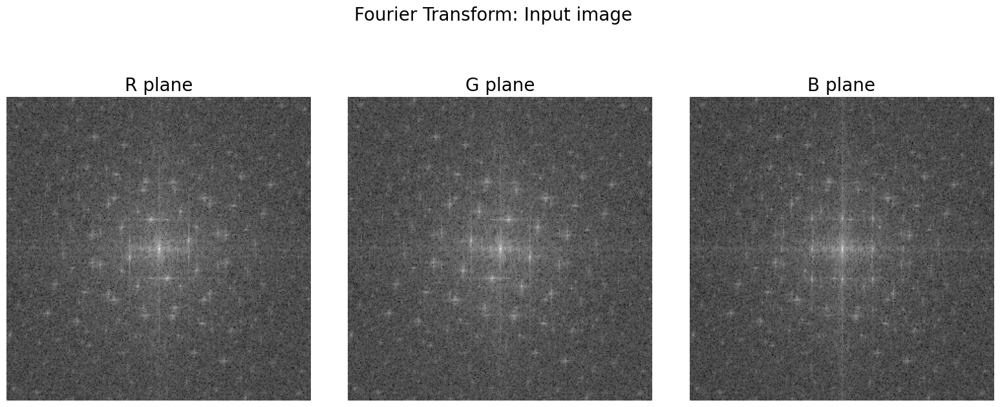

In [1]:
# Import modules
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, util, exposure, filters
from pylab import *
from scipy import ndimage

data_dir = '../sekvence'

# Define helper functions
def define_coordinates(Ny, Nx):
    """
    Return pixel coordinates array based on image shape.

    Parameters
    -----
    Ny: int
        Image height.
    Nx: int
        Image width.

    Returns
    -----
    x : ndarray
        Image width coordinate array.
    y : ndarray
        Image height coordinate array.
    """
    if (Ny%2 == 0): # Even number of coordinates
        y = np.arange(0,Ny) - Ny/2 + 0.5 # Make number of positive and negative coordinates the same
    else:
        y = np.arange(0,Ny) - (Ny-1)/2
    
    if (Nx%2 == 0):
        x = np.arange(0,Nx) - Nx/2 + 0.5
    else:
        x = np.arange(0,Nx) - (Nx-1)/2
    return x, y

def gaussian_filter(img_fft, sigma):
    """
    Filter image FFT using Gaussian filter.

    Parameters
    -----
    img_fft: ndarray
        Input image FFT.
    sigma: int
        Standard deviation of Gaussian distribution.

    Returns
    -----
    filtered_fft : ndarray
        FFT of filtered image.
    """
    Ny, Nx = img_fft.shape
    x, y = define_coordinates(Ny, Nx)

    X, Y = meshgrid(x, y)
    D = np.sqrt(np.square(X) + np.square(Y)) # Distance froom origin array
    filter_mask = exp(-np.square(D)/(2*np.square(sigma)))
    return img_fft*filter_mask


def gaussian_notch_filter(img_fft, sigma, Dx, Dy):
    """
    Filter image FFT using Gaussian notch filter.

    Parameters
    -----
    img_fft: ndarray
        Input image FFT.
    sigma: int
        Standard deviation of Gaussian distribution.
    Dx: int
        Notch origin X coordinate.
    Dy: int
        Notch origin Y coordinate.

    Returns
    -----
    filtered_fft : ndarray
        FFT of filtered image.
    """
    Ny, Nx = img_fft.shape
    x, y = define_coordinates(Ny, Nx)
    
    X1, Y1 = meshgrid(x-Dx, y-Dy)    
    D1 = np.sqrt(np.square(X1) + np.square(Y1))
    
    # Centrally symmetric coordinates
    X2, Y2 = meshgrid(x+Dx, y+Dy)
    D2 = np.sqrt(np.square(X2) + np.square(Y2))
    
    # Define filter mask
    filter_mask = 1 - exp(-np.square(D1)/(2*np.square(sigma))) - exp(-np.square(D2)/(2*np.square(sigma)))
    return img_fft*filter_mask

def square_br_filter(img_fft, x1, y1, x2, y2):
    """
    Filter image FFT using ideal band reject filter in a shape of square.

    Parameters
    -----
    img_fft: ndarray
        Input image FFT.
    x1: int
        X coordinate of first square's bottom-right corner.
    y1: int
        Y coordinate of first square's bottom-right corner.
    x2: int
        X coordinate of second square's bottom-right corner.
    y2: int
        Y coordinate of second square's bottom-right corner.

    Returns
    -----
    filtered_fft : ndarray
        FFT of filtered image.
    """
    Ny, Nx = img_fft.shape
    x, y = define_coordinates(Ny, Nx)
    X, Y = meshgrid(x, y)
    filter_mask = np.ones(img_fft.shape)
    filter_mask[(abs(X)>x1) & (abs(X)<x2) & (abs(Y)<y2)] = 0
    filter_mask[(abs(Y)>y1) & (abs(Y)<y2) & (abs(X)<x2)]=0
    return img_fft*filter_mask

def plot_fft_planes(fft_R, fft_G, fft_B, title):
    """
    Plot FFT of each plane of the RGB image.

    Parameters
    -----
    fft_R: ndarray
        Input image's R plane FFT.
    fft_G: ndarray
        Input image's G plane FFT.
    fft_B: ndarray
        Input image's B plane FFT.
    title: string
        Plot suptitle.
    """
    fig, axs = plt.subplots(1,3, figsize=(16,8), dpi=100)
    plt.tight_layout()
    plt.suptitle(title, fontsize=20)
    axs[0].imshow(log(1+abs(fft_R)), cmap='gray')
    axs[0].set_title('R plane', fontsize=20)
    axs[0].set_axis_off()
    axs[1].imshow(log(1+abs(fft_G)), cmap='gray')
    axs[1].set_title('G plane', fontsize=20)
    axs[1].set_axis_off()
    axs[2].imshow(log(1+abs(fft_B)), cmap='gray')
    axs[2].set_title('B plane', fontsize=20)
    axs[2].set_axis_off()
    plt.show()

def fft2img(fft_R, fft_G, fft_B):
    """
    Do Inverse FFT of each plane of RGB image.

    Parameters
    -----
    fft_R: ndarray
        Input image's R plane FFT.
    fft_G: ndarray
        Input image's G plane FFT.
    fft_B: ndarray
        Input image's B plane FFT.
        
    Returns
    -----
    out: ndarray
        RGB image in spatial domain.
    """

    # Inverse Fast Fourier Transform
    R=real(ifft2(ifftshift(fft_R)))
    G=real(ifft2(ifftshift(fft_G)))
    B=real(ifft2(ifftshift(fft_B)))

    # Create output image
    out=np.zeros(img.shape)
    out[:,:,0]=np.clip(R,0, 1)
    out[:,:,1]=np.clip(G,0, 1)
    out[:,:,2]=np.clip(B,0, 1)

    return out

# Read image
img = util.img_as_float64(io.imread('/'.join([data_dir, 'half_tone.jpg'])))

# Fast Fourier Transform
img_fft_R = fftshift(fft2(img[:,:,0]))
img_fft_G = fftshift(fft2(img[:,:,1]))
img_fft_B = fftshift(fft2(img[:,:,2]))

# Plot Fourier Transform
plot_fft_planes(img_fft_R, img_fft_G, img_fft_B, 'Fourier Transform: Input image')

## Gausov filtar
Gausov filtar u prostornom i frekvencijskom domenu imaju isti oblik. Parametar $sigma$ u ovom slučaju treba podesiti tako da se otklone visoke učestanosti, čime se eliminiše šum, ali i lokalni maksimumi vidljivi na grafiku Furijeove transformacije.

U sledećem delu koda izvršeno je usrednjavanje Gausovim filtrom u frekvencijskom domenu svake ravni slike, i prikazani su rezultati u frekvencijskom, kao i u prostornom domenu.

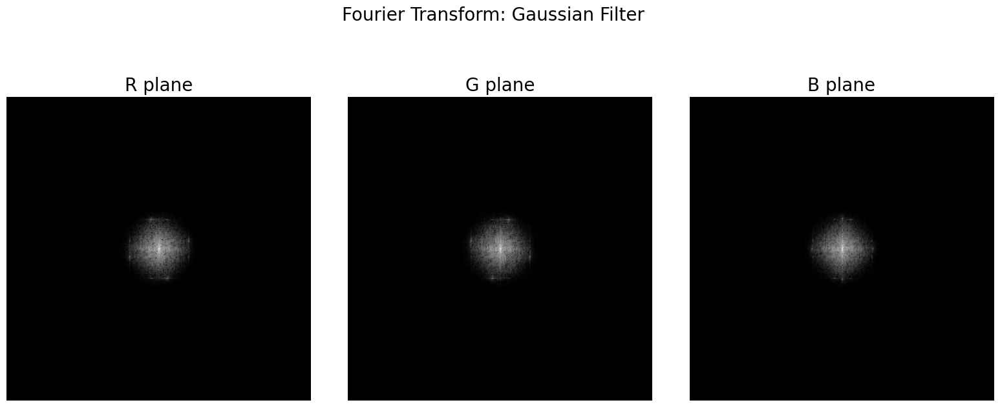

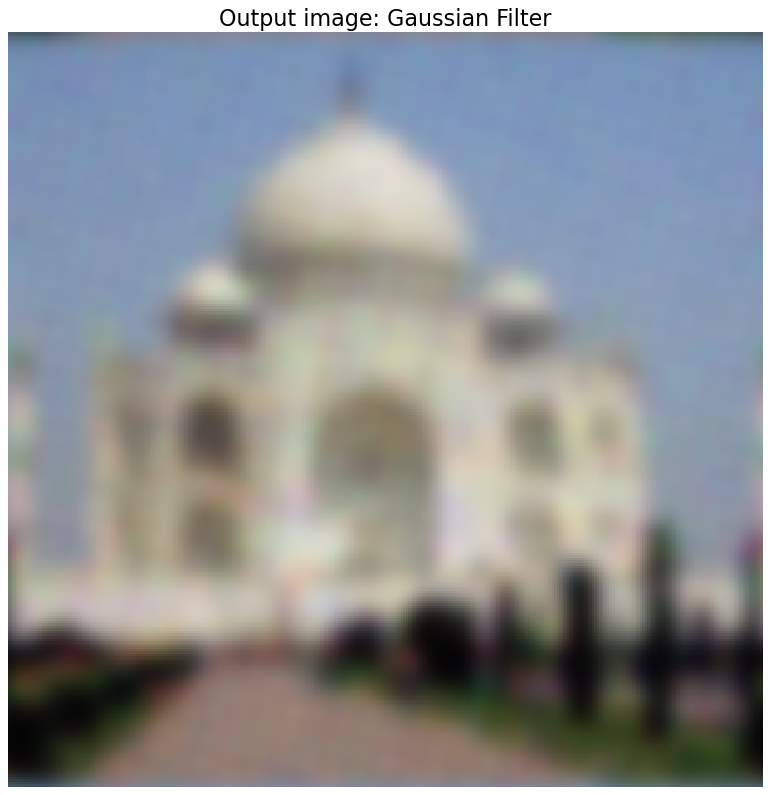

In [2]:
# Gaussian Filter Only
img_fft_R_filt = gaussian_filter(img_fft_R, 10)
img_fft_G_filt = gaussian_filter(img_fft_G, 10)
img_fft_B_filt = gaussian_filter(img_fft_B, 10)

# Plot Fourier Transform
plot_fft_planes(img_fft_R_filt, img_fft_G_filt, img_fft_B_filt, 'Fourier Transform: Gaussian Filter')

out1 = fft2img(img_fft_R_filt, img_fft_G_filt, img_fft_B_filt)

# Plot output image
plt.figure(figsize=(10,10), dpi=80)
io.imshow(out1)
plt.title('Output image: Gaussian Filter', fontsize=20)
plt.axis('off');

Sa slika Furijeovih transformacija ravni se vidi da ovaj filtar uklanja većinu lokalnih maksimuma u frekvencijskom domenu, što dovodi do lepo raspoređenih boja na slici. Međutim, filtar uklanja i željene komponente koje predstavljaju detalje, pa je zbog toga slika na izlazu veoma mutna, gotovo bez ikakvih ivica i samo sa naznakama onoga što se na njoj nalazi. Za bolje rezultate neophodno je primeniti drugačiji pristup.

## *Notch* filtar
Drugi pristup rešavanju ovog zadatka jeste primena Gausovog filtra koji ima veću vrednost parametra $sigma$, ali i Gausovog *notch* filtra. *Notch* filtri su tipovi filtara koji imaju pomerene koordinate centra - predstavljaju *Band Pass* ili *Band Reject* tipove filtara. Za rešavanje ovog zadatka korišćeni su *Band Reject Notch* filtri, čiji se centri poklapaju sa lokalnim maksimumima logaritma amplitudske karakteristike slike. Sama vrsta filtra može biti bilo koja (idealni, Gausov, *Butterworth*, ...) - zbog malog nepropusnog opsega razlike u dobijenim rezultatima nisu velike. Za rešavanje ovog zadatka korišćen je Gausov *Notch* filtar. Takođe, potrebno je koristiti i standardni Gausov filtar koji potiskuje visoke učestanosti, čime potiskuje šum.

Prilikom koriščenja *Notch* filtara neophodno je odrediti lokalne maksimume amplitudske karakteristike, čije će koordinate predstavljati centre filtara. Zbog naglog smanjenja vrednosti sa porastom učestanosti, za ovaj algoritam koriščen je logaritam amplitudske karakteristike. Takođe, prag sa kojim se frekvencijske komponente porede smanjuje se sa porastom učestanosti, odnosno udaljenosti od DC vrednosti, u skladu sa osobinama signala u spektru. Ovakav algoritam daje adekvatne rezultate, što će kasnije biti prikazano.

Sledeći deo koda realizuje propuštanje svih ravni slike kroz Gausov i Gausov *Band Reject Notch* filtar. Takođe, prikazuje rezultate u frekvencijskom domenu po ravnima, i konačan rezultat filtriranja.

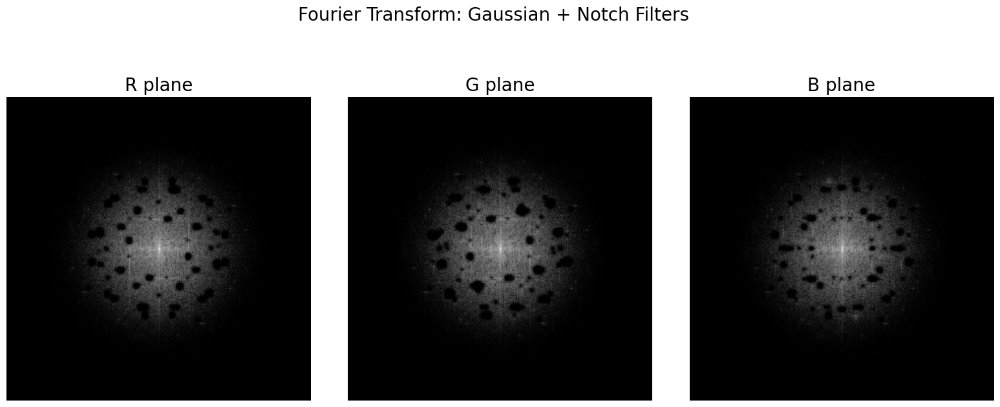

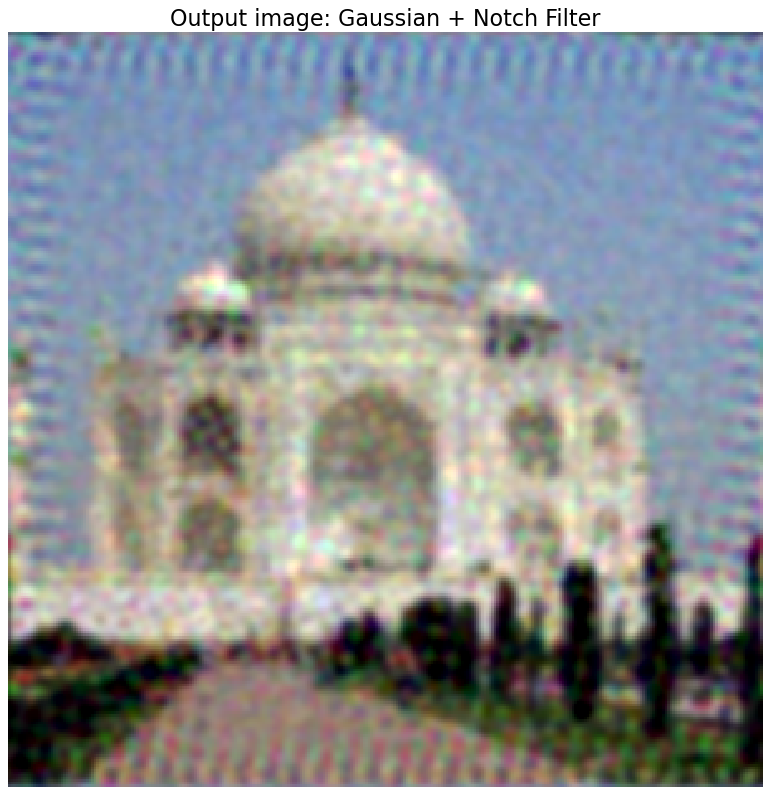

In [3]:
# Apply Gaussian filters
img_fft_R_filt = gaussian_filter(img_fft_R, 28)
img_fft_G_filt = gaussian_filter(img_fft_G, 28)
img_fft_B_filt = gaussian_filter(img_fft_B, 28)

# Apply Notch filters

# Define coordinate arrays
Ny, Nx = img_fft_R.shape
x, y = define_coordinates(Ny, Nx)
X, Y = meshgrid(x, y)
D = np.sqrt(np.square(X) + np.square(Y))

# Define constants
thresh = 190
sigma = 2
    
# Calculate logarithms of magnitude spectrum
fft_R_log = log(1+abs(img_fft_R_filt))
fft_G_log = log(1+abs(img_fft_G_filt))
fft_B_log = log(1+abs(img_fft_B_filt))

# Define mask for each plane
mask_R = (fft_R_log>thresh/D) & (D>(Nx+Ny)/2*0.05)
mask_R_ind = np.where(mask_R)
mask_G = (fft_G_log>thresh/D) & (D>(Nx+Ny)/2*0.05)
mask_G_ind = np.where(mask_G)
mask_B = (fft_B_log>thresh/D) & (D>(Nx+Ny)/2*0.05)
mask_B_ind = np.where(mask_B)

# Apply notch filter to every peak of every plane
for i, j in zip(mask_R_ind[0]-Nx/2, mask_R_ind[1]-Ny/2):
    img_fft_R_filt=gaussian_notch_filter(img_fft_R_filt, sigma, i, j)

for i, j in zip(mask_G_ind[0]-Nx/2, mask_G_ind[1]-Ny/2):
    img_fft_G_filt=gaussian_notch_filter(img_fft_G_filt, sigma, i, j)

for i, j in zip(mask_B_ind[0]-Nx/2, mask_B_ind[1]-Ny/2):
    img_fft_B_filt=gaussian_notch_filter(img_fft_B_filt, sigma, i, j)

plot_fft_planes(img_fft_R_filt, img_fft_G_filt, img_fft_B_filt, 'Fourier Transform: Gaussian + Notch Filters')


out2 = fft2img(img_fft_R_filt, img_fft_G_filt, img_fft_B_filt)

# Plot output image
plt.figure(figsize=(10,10), dpi=80)
io.imshow(out2)
plt.title('Output image: Gaussian + Notch Filter', fontsize=20)
plt.axis('off');

Na prikazu Furijeove transformacije se vidi da su potisnute sve spektralne komponente na kojima su bili uočljivi lokalni maksimumi. To je dovelo do potiskivanja periodičnih smetnji na slici, odnosno razlivanja boja na željenim mestima. Na samoj slici se vidi vidno poboljšanje u količini detalja u odnosu na prethodni pristup. Međutim, smetnje su još uvek vidljive, pa je potrebno primeniti još jedan filtar kako bi se one dodatno potisnule.

## Idealni filtar nepropusnik opsega učestanosti
Na prethodnom prikazu Furijeove transformacije slike uočljiv je u sve tri ravni kvadratni oblik u kome su vrednosti logaritma amplitudske karakteristike veće u odnosu na okolinu. Ovaj oblik biće uklonjen primenom idealnog filtra nepropusnika opsega učestanosti oblika kvadrata. Idealni filtar je izabran pre svega zbog toga što se može definisati tako da odgovara kvadratnom obliku kakav je potreban za otklanjanje.

U sledećem segmentu koda primenjen je ovaj filtar na dosadašnji rezultat i prikazani su rezultati u frekvencijskom i u prostornom domenu.

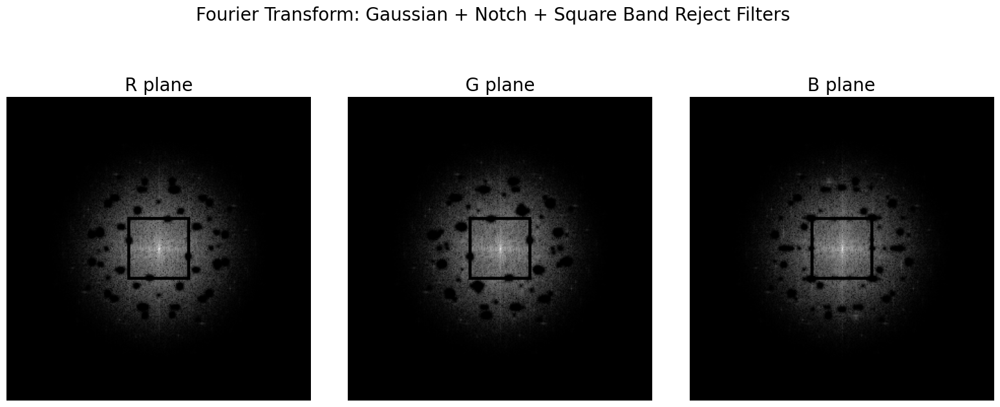

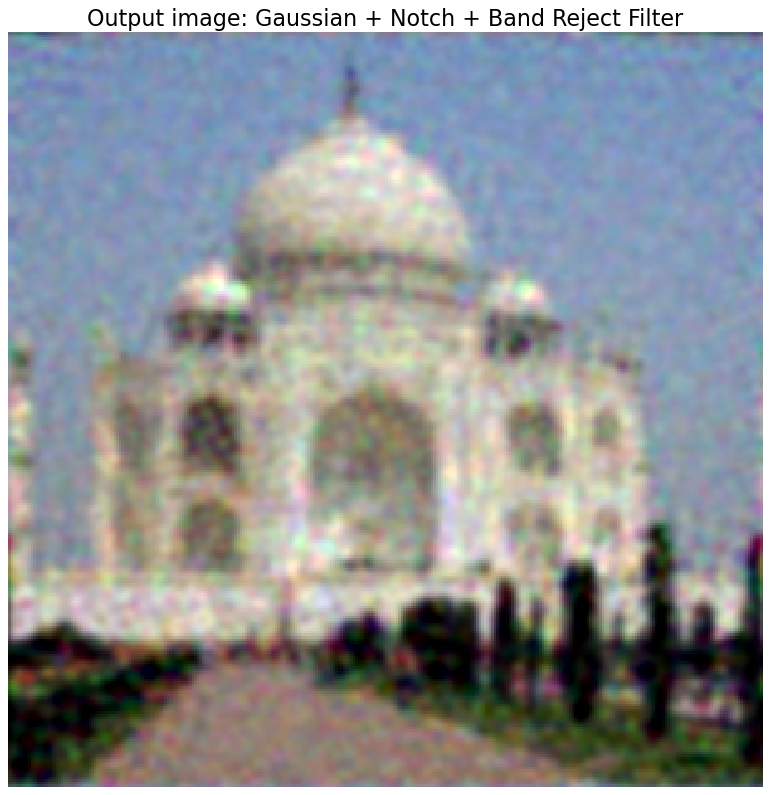

In [4]:
# Apply square Band Reject filter

img_fft_R_filt = square_br_filter(img_fft_R_filt, 28, 28, 31, 31)
img_fft_G_filt = square_br_filter(img_fft_G_filt, 28, 28, 31, 31)
img_fft_B_filt = square_br_filter(img_fft_B_filt, 28, 28, 31, 31)

plot_fft_planes(img_fft_R_filt, img_fft_G_filt, img_fft_B_filt, 'Fourier Transform: Gaussian + Notch + Square Band Reject Filters')

out3 = fft2img(img_fft_R_filt, img_fft_G_filt, img_fft_B_filt)

# Plot output image
plt.figure(figsize=(10,10), dpi=80)
io.imshow(out3)
plt.title('Output image: Gaussian + Notch + Band Reject Filter', fontsize=20)
plt.axis('off');


Prikaz Furijeove transformacije pokazuje da su spektralne komponente u željenom području u potpunosti uklonjene. Parametri filtara izabrani su upravo tako da filtar obuhvata željeno područje. Na slici se vidi vidno poboljšanje u smislu potiskivanja neželjenih periodičnih smetnji. Ovim je završen postupak inverznog polutoniranja.

Sledeći deo koda iscrtava poređenje originalne slike i slike nakon svakog koraka obrade.

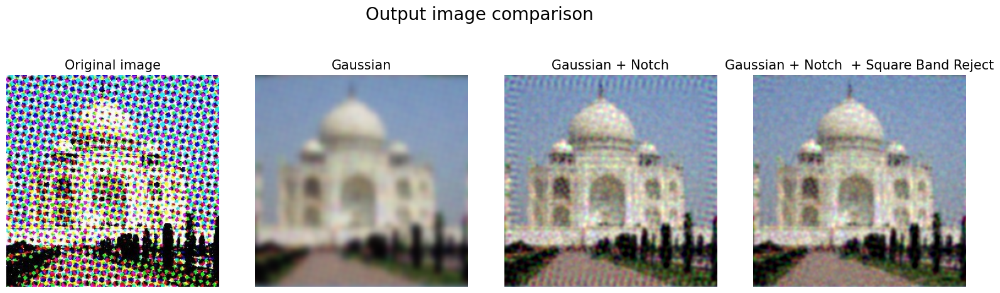

In [5]:
fig, axs = plt.subplots(1,4, figsize=(16,6), dpi=100)
axs = axs.ravel()
plt.tight_layout()
plt.suptitle('Output image comparison', fontsize=20)
axs[0].imshow(img)
axs[0].set_title('Original image', fontsize=15)
axs[0].set_axis_off()
axs[1].imshow(out1)
axs[1].set_title('Gaussian', fontsize=15)
axs[1].set_axis_off()
axs[2].imshow(out2)
axs[2].set_title('Gaussian + Notch', fontsize=15)
axs[2].set_axis_off()
axs[3].imshow(out3)
axs[3].set_title('Gaussian + Notch  + Square Band Reject', fontsize=15)
axs[3].set_axis_off()
plt.show()

Uporednim prikazom rezultata jasno se vidi razlog koriščenja *Notch* i idealnog *Band Reject* filtra. Konačna slika još uvek nema u potpunosti jasno izražene detalje, ali je dovoljna za jasno prepoznavanje objekata koji se na njoj nalaze. Ovim zadatkom pokazan je značaj primenjenih filtara, kao i jednostavnost filtriranja u frekvencijskom domenu.

# Zadatak 2
U drugom zadatku potrebno je izvršiti restauraciju slike *etf_blur.tif* sa zamućenjem usled pokreta, na osnovu poznatog pokreta kamere datog na slici *kernel.tif*. Potrebno je obratiti pažnju na to da proces zamućenja ne menja srednju vrednost intenziteta slike.

## Degradacija usled pokreta
Degradaciju usled pokreta neophodno je posmatrati kao linearnu, prostorno invarijantnu degradaciju. Na osnovu toga model sistema koji na svom izlazu daje degradiranu sliku može se predstaviti na sledeći način:

$$g(x,y)=f(x,y)*h(x,y)+\eta(x,y)$$
gde je:
- $g(x,y)$ degradirana slika
- $f(x,y)$ originalna, "skrivena" slika pre degradacije
- $h(x,y)$ impulsni odziv degradacije
- $\eta(x,y)$ aditivni šum

Prilikom rešavanja ovog zadatka pretpostavlja se da nema aditivnog šuma koji se dodaje na rezultat konvolucije, odnosno $\eta(x,y)=0$. U tom slučaju slika pre degradacije se može dobiti kao rezultat dekonvolucije degradirane slike i impulsnog odziva degradacije. Dekonvoluciju je mnogo jednostavnije izvršiti u frekvencijskom domenu, jer se tada ona slika u deljenje. Zbog toga je pre svega potrebno izraziti sliku i degradaciju u spektralnom domenu.

## Spektar slike i degradacije

Predstavljanje slike u frekvencijskom domenu, kao i funkcije korišćene za njeno određivanje, objašnjeni su u prethodnom zadatku. Isti princip važi za sliku i degradaciju u ovom zadatku, s tim što u ovom slučaju treba obratiti pažnju na broj tačaka u kojima se računa brza Furijeova transformacija degradacije. Kako bi operacija dekonvolucije bila adekvatno izvedena, potrebno je da FFT slike i degradacije budu izračunate u istom broju tačaka.

U sledećem segmentu koda definisane su pomoćne funkcije korišćene kasnije. Dalje, učitane su reprezentacije degradirane slike i degradacije u prostornom domenu. Na kraju, izvršene su brze Furijeove transformacije degradirane slike i degradacije, centriranje njihovih spektara i prikazane su njihove amplitudske karakteristike. Zbog velikih razlika intenziteta različitih spektralnih komponenti amplitudske karakteristike prikazane su na logaritamskoj skali.

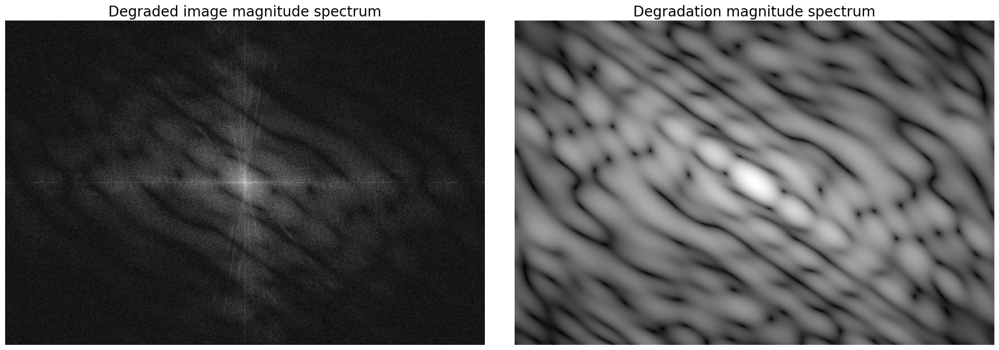

In [6]:
# Import modules
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, util, restoration, exposure
from pylab import *

# Define helper functions
def define_coordinates(Ny, Nx):
    """
    Return pixel coordinates array based on image shape.

    Parameters
    -----
    Ny: int
        Image height.
    Nx: int
        Image width.

    Returns
    -----
    x : ndarray
        Image width coordinate array.
    y : ndarray
        Image height coordinate array.
    """
    if (Ny%2 == 0):
        y = np.arange(0,Ny) - Ny/2 + 0.5
    else:
        y = np.arange(0,Ny) - (Ny-1)/2
    
    if (Nx%2 == 0):
        x = np.arange(0,Nx) - Nx/2 + 0.5
    else:
        x = np.arange(0,Nx) - (Nx-1)/2
    return x, y

def butterworth_filter(img_fft, sigma, n):
    """
    Filter image FFT using Butterworth filter.

    Parameters
    -----
    img_fft: ndarray
        Input image FFT.
    sigma: int
        Cutoff frequency.
    n: int
        Butterworth filter order.

    Returns
    -----
    filtered_fft : ndarray
        FFT of filtered image.
    """
    Ny, Nx = img_fft.shape
    x, y = define_coordinates(Ny, Nx)

    X, Y = meshgrid(x, y)
    D = np.sqrt(np.square(X) + np.square(Y))
    filter_fft = 1/(1+(D/sigma)**(2*n))
    return img_fft*filter_fft

def gaussian_filter(img_fft, sigma):
    """
    Filter image FFT using Gaussian filter.

    Parameters
    -----
    img_fft: ndarray
        Input image FFT.
    sigma: int
        Standard deviation of Gaussian distribution.

    Returns
    -----
    filtered_fft : ndarray
        FFT of filtered image.
    """
    Ny, Nx = img_fft.shape
    x, y = define_coordinates(Ny, Nx)

    X, Y = meshgrid(x, y)
    D = np.sqrt(np.square(X) + np.square(Y))
    filter_mask = exp(-np.square(D)/(2*np.square(sigma)))
    return img_fft*filter_mask

#Read image and kernel
img = util.img_as_float(io.imread('/'.join([data_dir, 'etf_blur.tif'])))
kernel = util.img_as_float(io.imread('/'.join([data_dir, 'kernel.tif'])))

[Ny, Nx] = shape(img) # Get image shape

 # Get Fast Fourier Transform of image and kernel
img_fft = fftshift(fft2(img))
kernel_fft=fftshift(fft2(kernel, img.shape))

# Plot results
fig, axs =plt.subplots(1,2, figsize=(20,16), dpi=100)
plt.tight_layout()
axs[0].imshow(log(1+abs(img_fft)), cmap='gray')
axs[0].set_title('Degraded image magnitude spectrum', fontsize=20)
axs[0].set_axis_off()
axs[1].imshow(log(1+abs(kernel_fft)), cmap='gray')
axs[1].set_axis_off()
axs[1].set_title('Degradation magnitude spectrum', fontsize=20);

Poređenjem se mogu uočiti slični šabloni koji se javljaju na amplitudskim spektrima degradirane slike i degradacije. To pokazuje da spektar degradirane slike predstavlja proizvod originalne slike i spektra degradacije. Takođe, može se primetiti da su spektri centralno simetrični, što je odlika realnih signala.

## Dekonvolucija

Da bi se došlo do originalne slike, potrebno je izvršiti dekonvoluciju degradirane slike i degradacije. Ovu operaciju je mnogo lakše izvesti u spektralnom domenu, zato što se svodi na deljenje spektara degradirane slike i degradacije.

## Održavanje srednje vrednosti intenziteta slike
Informacija o srednjoj vrednosti intenziteta slike sadržana je u DC komponenti spektra slike. Da bi se ona održala, potrebno je skalirati FFT degradacije tako da njegova DC komponenta bude jednaka 1. Na taj način pilikom deljenja FFT slike i degradacije ne dolazi do promene DC komponente slike, čime se čuva njena originalna srednja vrednost.

U sledećem delu koda izvršeno je skaliranje FFT degradacije tako da se procesom dekonvolucije u spektru ne menja DC komponenta slike. Dalje, izvršena je dekonvolucija deljenjem spektara degradirane slike i degradacije, čime je dobijen spektar originalne slike. Prikazan je amplitudski spektar rezultata dekonvolucije na logaritamskoj skali.

Rescaled kernel DC component:  (1+0j)
Image DC komponent before deconvolution:  (173245.97254901959-5.254006431310021e-12j)
Image DC component after deconvolution:  (173245.97254901959-5.254006431310021e-12j)


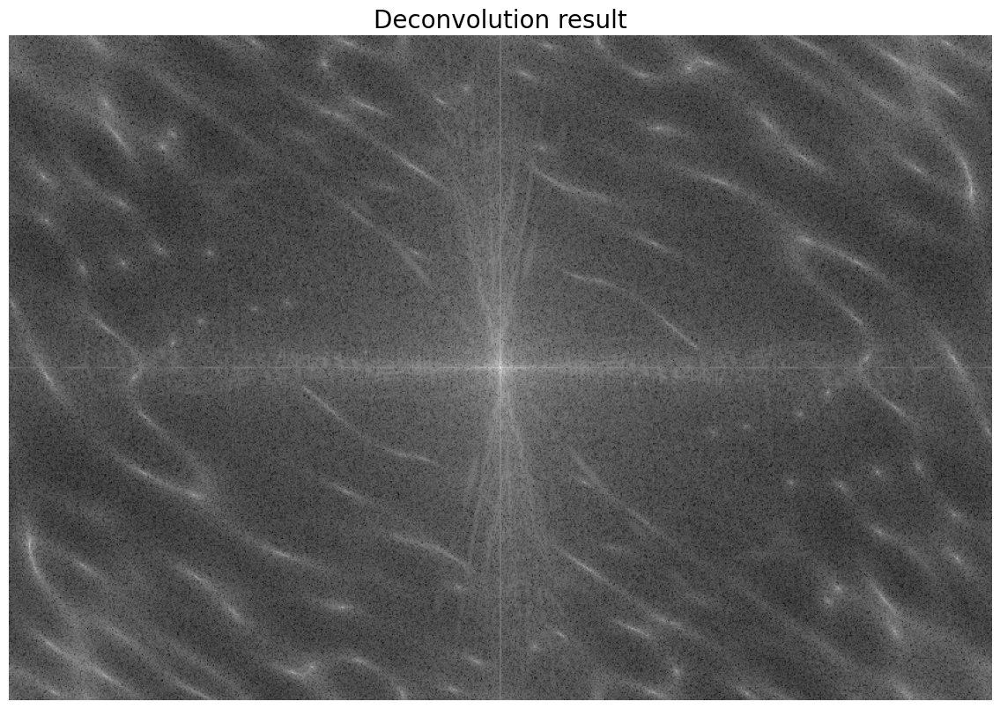

In [7]:
# Rescale kernel FFT values
kernel_dc = ifftshift(kernel_fft)[0,0]
kernel_fft=kernel_fft/kernel_dc
print('Rescaled kernel DC component: ', ifftshift(kernel_fft)[0,0])

print('Image DC komponent before deconvolution: ',ifftshift(img_fft)[0,0])

# Deconvolution
latent_fft =img_fft/kernel_fft
print('Image DC component after deconvolution: ',ifftshift(latent_fft)[0,0])

# Plot results
plt.figure(dpi=100, figsize=(16,10))
plt.title('Deconvolution result', fontsize=20)
plt.axis('off')
plt.imshow(log(1+abs(latent_fft)), cmap='gray');

Dobijeni rezultat bi u idealnom slučaju trebalo da predstavlja spektar originalne slike. Međutim, sa rezultata se mogu primetiti spektralne komponente na visokim učestanostima koje nose veliki procenat energije. U realnom svetu najveći procenat energije nose spektralne komponente bliske nultoj učestanosti, pa je zbog toga na rezultat dekonvolucije potrebno primeniti NF filtar.

## Niskofrekventno filtriranje

Niskofrekventnim filtriranjem potiskuju se komponente na visokim učestanostima, a propuštaju komponente na niskim učestanostima. Na taj način ne dozvoljavaju se brze promene vrednosti intenziteta piksela, koje predstavljaju detalje ili šum. U ovom zadatku potrebno je odrediti tip NF filtra koji sa jedne strane dovoljno potiskuje komponente na visokim učestanostima tako da nema neželjenih promena intenziteta piksela na slici, a sa druge strane dovoljno propušta komponente na niskim učestanostima tako da ne poništi rezultate dekonvolucije.

Evidentno je da će primena idelanog filtra dosta pogoršati rezultat dekonvolucije, zato što potpuno potiskuje sve komponente van određenog opsega učestanosti. Visoke učestanosti koje umanjuju zamućenje usled pokreta moraju se potisnuti, ali se ne bi smele u potpunosti ukloniti. Zbog toga će mnogo bolje rezultate dati Gausov ili *Butterworth*-ov filtar, koji ne uklanjaju u potpunosti ove spektralne komponente.

Prilikom filtriranja treba obratiti pažnju na to da ne dolazi do promene vrednosti DC komponente slike. Na taj način se održava srednja vrednost intenziteta slike, kao što je naglašeno u zadatku.

Sledeći deo koda predstavlja primenu Gausovog i *Butterworth* filtra sa različitim parametrima na rezultat dekonvolucije. Za različite parametre ovih filtara prikazani su rezultati filtriranja.

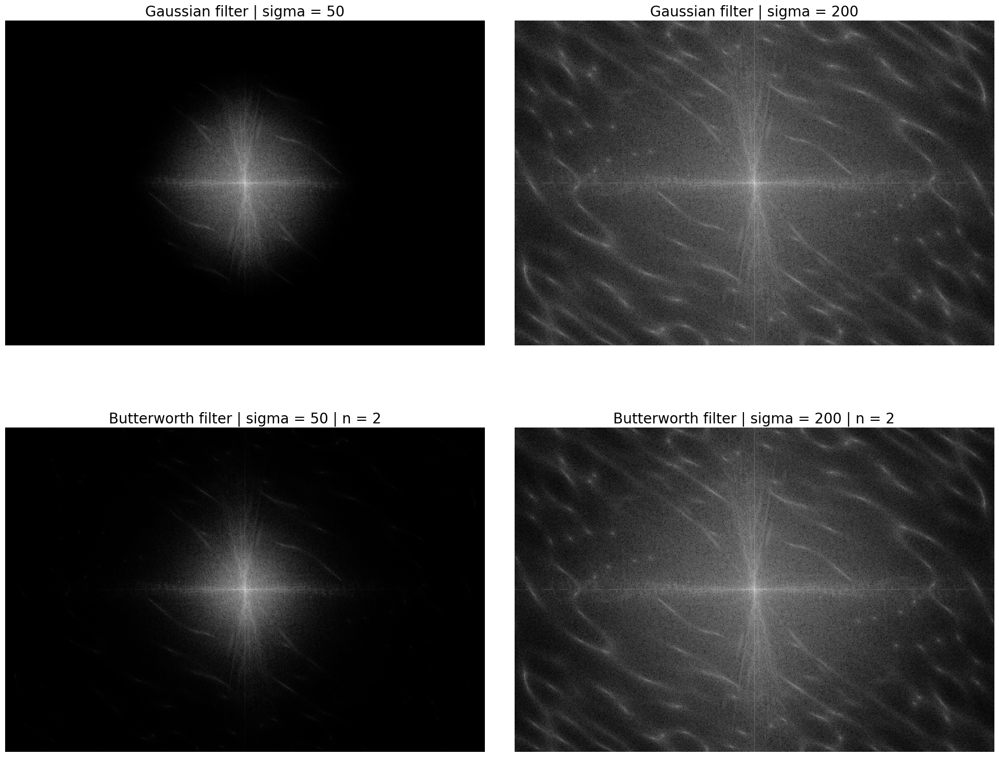

In [8]:
# Apply filters
latent_fft1 = gaussian_filter(latent_fft, 50)
latent_fft2 = gaussian_filter(latent_fft, 200)
latent_fft3 = butterworth_filter(latent_fft, 50, 2)
latent_fft4 = butterworth_filter(latent_fft, 200, 2)

# Plot results
fig, axs = plt.subplots(2,2, figsize=(20,16), dpi=100)
plt.tight_layout()
axs[0, 0].imshow(log(1+abs(latent_fft1)), cmap='gray')
axs[0, 0].set_axis_off()
axs[0, 0].set_title('Gaussian filter | sigma = 50', fontsize=20)
axs[0, 1].imshow(log(1+abs(latent_fft2)), cmap='gray')
axs[0, 1].set_axis_off()
axs[0, 1].set_title('Gaussian filter | sigma = 200', fontsize=20)
axs[1, 0].imshow(log(1+abs(latent_fft3)), cmap='gray')
axs[1, 0].set_axis_off()
axs[1, 0].set_title('Butterworth filter | sigma = 50 | n = 2', fontsize=20)
axs[1, 1].imshow(log(1+abs(latent_fft4)), cmap='gray')
axs[1, 1].set_axis_off()
axs[1, 1].set_title('Butterworth filter | sigma = 200 | n = 2', fontsize=20);

Rezultati pokazuju vidno potiskivanje signala dalje od centra, odnosno na višim učestanostima, kao što je i očekivano. Takođe, vidi se da za vrednost $sigma=200$ potiskivanje nije veliko, što znači da u prostornom domenu rezultati verovatno neće biti adekvatni. Za oba *Butterworth* filtra korišćen je filtar drugog reda, jer sa povećanjem reda ovog filtra on sve više liči na idealni.

## Vraćanje u prostorni domen
Nakon izvršenih operacija nad spektralnim domenom potrebno je vratiti se u prostorni domen primenom inverzne diskretne Furijeove transformacije 2D signala, definisane formulom:

$$f(x,y)=\frac{1}{MN}\sum_{u=0}^{M-1}\sum_{v=0}^{N-1}F(u,v)e^{j2\pi(\frac{ux}{M}+\frac{vy}{N})}$$

U *Python*-u ovaj postupak je definisan u funkciji *ifft2()*. Naravno, zbog centriranja spektra koje je izvršeno ranije, pre inverzne brze Furijeove transformacije neophodno je vratiti spektar prrimenom funkcije *ifftshift()*. Na kraju, potrebno je odseći imaginarne delove koji su se pojavili zbog grešaka prilikom zaokruživanja u računaru, primenom funkcije *real()*.

U sledećem segmentu koda izvršeno je vraćanje obrađene slike u prostorni domen. Prikazani su rezultati dobijeni primenom različitih NF filtara na rezultat dekonvolucije.

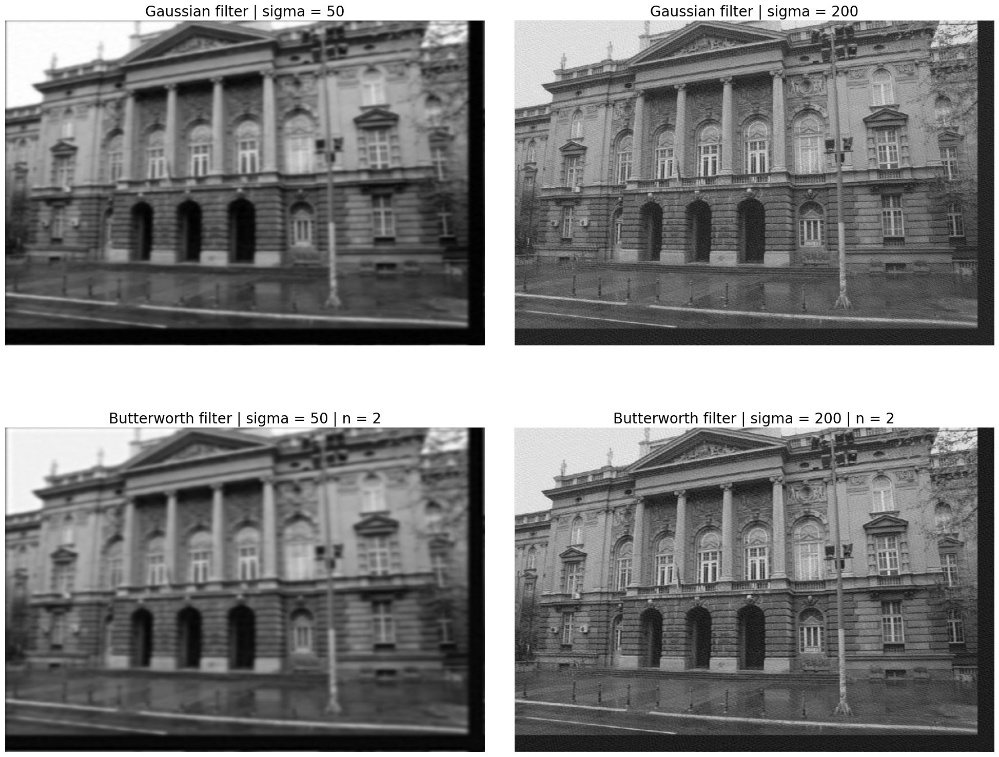

In [9]:
# Apply Inverse Fast Fourier Transform
latent1 = real(ifft2(ifftshift(latent_fft1)))
latent2 = real(ifft2(ifftshift(latent_fft2)))
latent3 = real(ifft2(ifftshift(latent_fft3)))
latent4 = real(ifft2(ifftshift(latent_fft4)))

# Plot results
fig, axs = plt.subplots(2,2, figsize=(20,16), dpi=100)
plt.tight_layout()
axs = axs.ravel()
axs[0].imshow(latent1, cmap='gray')
axs[0].set_title('Gaussian filter | sigma = 50', fontsize=20)
axs[0].set_axis_off()
axs[1].imshow(latent2, cmap='gray')
axs[1].set_title('Gaussian filter | sigma = 200', fontsize=20)
axs[1].set_axis_off()
axs[2].imshow(latent3, cmap='gray')
axs[2].set_title('Butterworth filter | sigma = 50 | n = 2', fontsize=20)
axs[2].set_axis_off()
axs[3].imshow(latent4, cmap='gray')
axs[3].set_title('Butterworth filter | sigma = 200 | n = 2', fontsize=20)
axs[3].set_axis_off()

Kao što je i pretpostavljano, vidi se da za vrednost $sigma=200$ postoje neželjene visoke učestanosti koje nijedan tip filtra nije uspešno otklonio. Sa druge strane, filtri sa $sigma=50$ previše potiskuju visoke učestanosti, čime umanjuju efekat dekonvolucije i vraćaju još uvek zamućenu sliku. Zaključak je da je adekvatna vrednost $sigma$ negde između ove dve vrednosti. Takođe, sa rezultata za $sigma=200$ vidi se da Gausov filtar daje oštriju sliku, što znači da on bolje čuva željeni rezultat dekonvolucije.

Sledeći deo koda filtrira rezultat dekonvolucije Gausovim filtrom sa parametrom $sigma=130$, za koji se dobijaju zadovoljavajući rezultati. Dalje, vraća sliku u prostorni domen i prikazuje poređenje degradirane slike i rezultata. Treba naglasiti da zbog skaliranja FFT degradacije i pažljivo definisanih filtara nije potrebno dodatno razvlačenje kontrasta, jer se srednja vrednost intenziteta slika održala konstantnom.

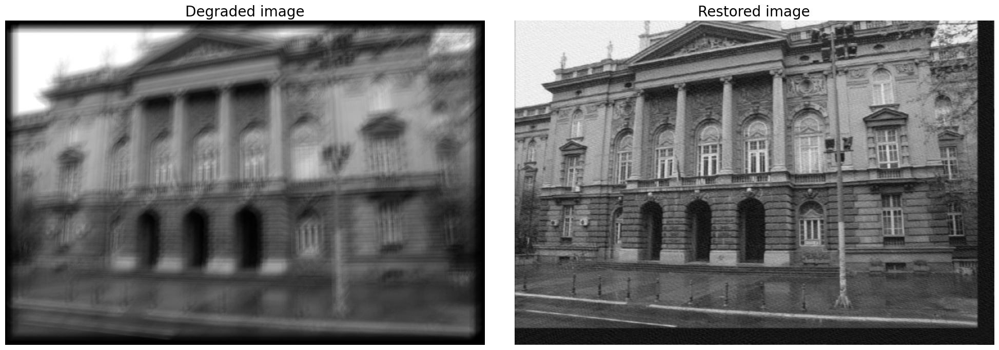

In [10]:
# Apply the best filter
latent_fft_final = gaussian_filter(latent_fft, 130)

# Apply inverse Fourier Transform
latent_final = real(ifft2(ifftshift(latent_fft_final)))

# Plot final comparison
fig, axs =plt.subplots(1,2, figsize=(20,16), dpi=100)
plt.tight_layout()
axs[0].imshow(img, cmap='gray')
axs[0].set_title('Degraded image', fontsize=20)
axs[0].set_axis_off()
axs[1].imshow(latent_final, cmap='gray')
axs[1].set_axis_off()
axs[1].set_title('Restored image', fontsize=20);

Poređenjem degradirane i obrađene slike vidi se značajno poboljšanje. Zamućenje usled šuma je gotovo u potpunosti otklonjeno, i jasno se vide svi detalji. Nažalost, tokom ovog procesa uveden je šum koji se manifestuje neželjenim artefaktima na slici. Ovaj šum je moguće umanjiti dodatnim filtriranjem, ali i sa njim slika je znatno bolja od prvobitne, degradirane slike.

# Zadatak 3
U trećem zadatku potrebno je proceniti varijansu šuma na slici *lena_noise.tif* i potisnuti ga korišćenjem adaptivnog filtriranja.

## Procena varijanse šuma
Varijansa šuma procenjuje se na osnovu histograma lokalnih varijansi slike. Varijansa u lokalnom susedstvu može se odrediti kao razlika srednje vrednosti kvadrata piksela tog susedstva i kvadrata srednje vrednosti ovih piksela. Nakon toga formira se histogram varijansi svih lokalnih susedstva, i za varijansu šuma se bira vrednost koja ima maksimalnu visinu na histogramu. Razlog tome jeste uvedena pretpostavka da u svakom lokalnom susedstvu većina piksela pripada unifomnim regionima slike. Ako svi pikseli susedstva potiču od istog izvora, razlika u njihovim intenzitetima biće posledica samo Gausovog šuma. Na osnovu toga smatra se da varijansa lokalnog susedstva predstavlja varijansu šuma. Ova pretpostavka nije u potpunosti tačna, pa  zbog toga različita lokalna susedstva imaju različite varijanse. Formiranjem histograma lokalnih varijansi može se odrediti varijansa lokalnog susedstva koju ima najveći broj susedstva, i ona se smatra za varijansu šuma.

U sledećem segmentu koda za opseg vrednosti radijusa lokalnog susedstva $r=[1,20]$ određene su varijanse lokalnih susedstva, formirani su histogrami lokalnih varijansi i na osnovu njih odabrane su vrednosti varijansi šuma. Prikazani su rezultati u zavisnosti od vrednosti radijusa $r$, kao i histogrami lokalnih varijansi za neke vrednosti radijusa $r$.

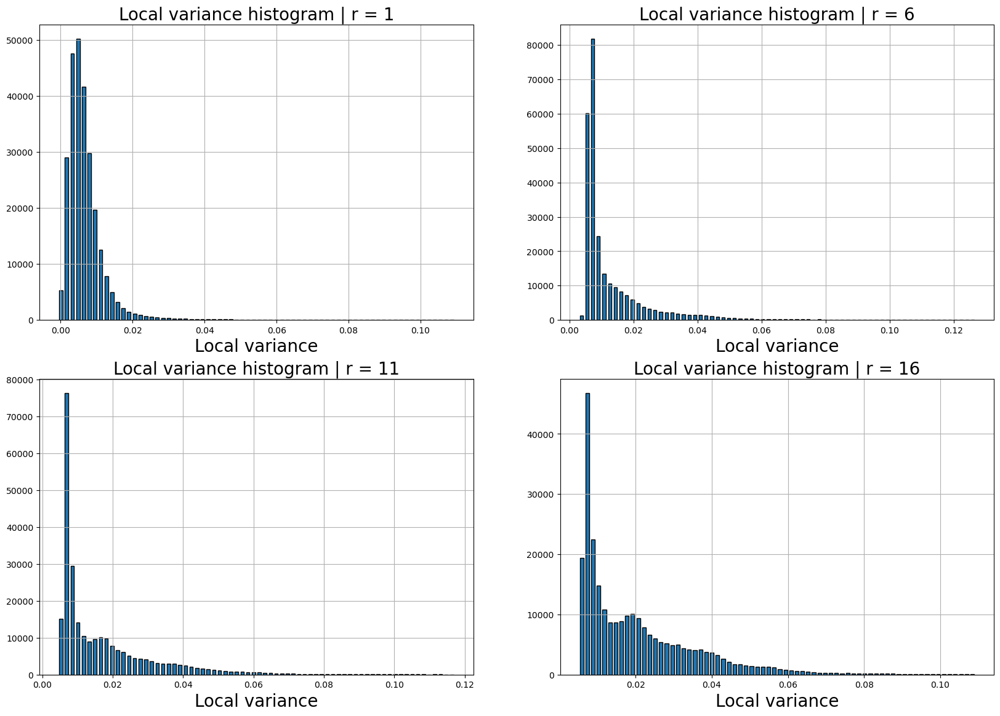

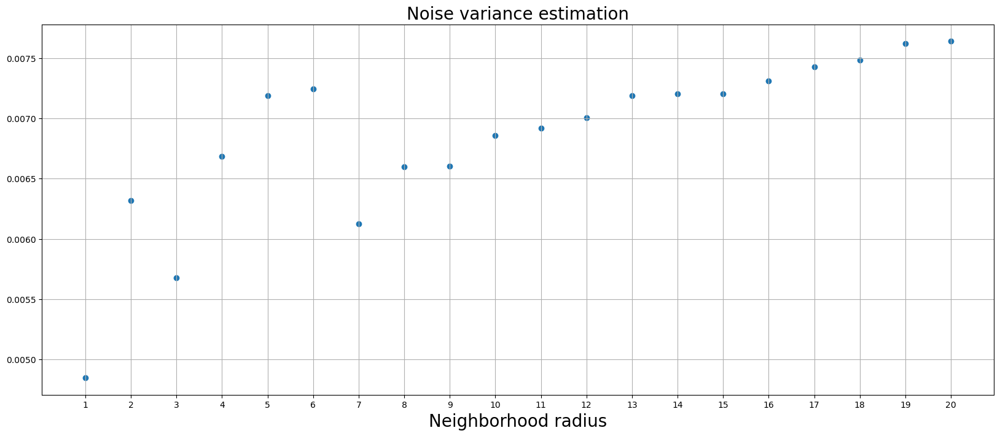

In [11]:
#Import modules
from skimage import util, io
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage

# Read image
img = util.img_as_float64(io.imread('/'.join([data_dir, 'lena_noise.tif'])))

noise_var_list = [] # List of results

fig, axes = plt.subplots(2,2, dpi=100, figsize=(20,14))
axs = axes.ravel()

for r in np.arange(1,21):
    
    s = 2*r+1 # Calculate neighborhood dimension
    
    # Calculate local variance matrix
    filt = np.ones((s,s))/(s**2) # Box filter
    avg = ndimage.correlate(img, filt) # Find average
    avg_sqr = ndimage.correlate(img**2,filt)
    local_var = avg_sqr - avg**2 # Local variance matrix

    # Calculate local variance histogram
    var_hist, bin_edges = np.histogram(local_var.flatten(), bins=70)
    
    # Find estimated noise variance
    noise_var = bin_edges[np.argmax(var_hist)]
    noise_var_list.append(noise_var)
    if(r%5==1):
        axs[r//5].bar(bin_edges[:-1], var_hist, linewidth=1, edgecolor='black', width=0.001)
        axs[r//5].set_title('Local variance histogram | r = '+ str(r), fontsize=20)
        axs[r//5].set_xlabel('Local variance', fontsize=20)
        axs[r//5].grid()
    
plt.figure(dpi=100, figsize=(20,8))
plt.scatter(np.arange(1,21), noise_var_list)
plt.xticks(np.arange(1,21))
plt.title('Noise variance estimation', fontsize=20)
plt.xlabel('Neighborhood radius', fontsize=20)
plt.grid()

Sa histograma i grafika iznad lako se uočava da su za različite vrednosti radijusa $r$ dobijene veoma slične procene varijanse šuma. Razlike koje postoje nastale su iz sledećih razloga:
- Za male vrednosti radijusa, odnosno male dimenzije lokalnog susedstva, broj piksela u susedstvu je premali da bi se efikasno procenila varijansa šuma. Iako je tada velika verovatnoća da svi pikseli u okviru susedstva potiču od istog izvora, broj odbiraka nije dovoljno veliki za adekvatnu procenu. Na grafiku je to prikazano većim razlikama između estimiranih vrednosti šuma za susedne vrednosti radijusa.
- Za velike vrednosti radijusa broj piksela lokalnog susedstva je dovoljan za procenu varijanse šuma. Međutim, sa porastom dimenzija lokalnog susedstva raste i verovatnoća da pikseli u okviru tog susedstva ne potiču od istog izvora. Ukoliko potiču od različitih izvora, region slike više nije uniforman, i prvobitna pretpostavka više nije ispunjena. To dovodi do toga da je procenjena varijansa šuma veća od prave.

Takođe, povećanjem radijusa se iz istih razloga povećava i procenjena varijansa lokalnih susedstva. Zbog toga veći broj susedstva ima veću varijansu od šuma, pa veći broj elemenata matrice težina korišćene za adaptivno filtriranje ima vrednost blisku nuli. Efektivno, detektovani detalji postaju mnogo "deblji" od pravih, odnosno ivice koje treba očuvati na matrici težina postaju prevelike. Kao posledica javlja se vidljiv prostor oko svake ivice u kome šum nije adekvatno otklonjen.

Navedeni razlozi dovode do zaključka da dimenzije lokalnih susedstva ne treba da budu ni premale ni prevelike. Zbog toga je za optimalni radijus izabrana vrednost $r=6$, koja daje estimiranu vrednost varijanse šuma $\sigma_n^2=0.0.0072$. Iako ova procena verovatno nije najbliža pravoj varijansi šuma, dovoljno je bliska njoj da rezultati budu zadovoljavajući. Sa druge strane, dodatno povećanje radijusa $r$ narušava kvalitet slike u delovima gde postoje ivice, što postaje veći problem od tačne procene varijanse šuma.

Sledeći segment koda ponavlja izračunavanja za vrednost radijusa $r=6$.

In [12]:
r=6
s = 2*r+1 # Calculate neighborhood dimension
    
# Calculate local variance matrix
filt = np.ones((s,s))/(s**2)
avg = ndimage.correlate(img, filt)
avg_sqr = ndimage.correlate(img**2,filt)
local_var = avg_sqr - avg**2

# Calculate local variance histogram
var_hist, bin_edges = np.histogram(local_var.flatten(), bins=70)
    
# Find estimated noise variance
noise_var = bin_edges[np.argmax(var_hist)]
print(noise_var)

0.007245104224672165


# Adaptivno filtriranje šuma

Za otklanjanje šuma korišćen je algoritam adaptivnog lokalnog usrednjavanja, koji na osnovu odnosa varijansi šuma i lokalnog susedstva detektuje koji pikseli sadrže šum, i to definiše u matrici težina $\omega(x,y)$. Na osnovu ove matrice piksele uniformnih regiona menja srednjom vrednošću lokalnog susedstva, dok se za piksele koji predstavljaju detalje vrši mnogo manje agresivno otklanjanje šuma, čime se čuvaju detalji.

U sledećem segmentu koda implementiran je metod adaptivnog lokalnog usrednjavanja za uklanjanje šuma sa slike *lena_noise.tif*. Prikazani su rezultati ovog postupka.

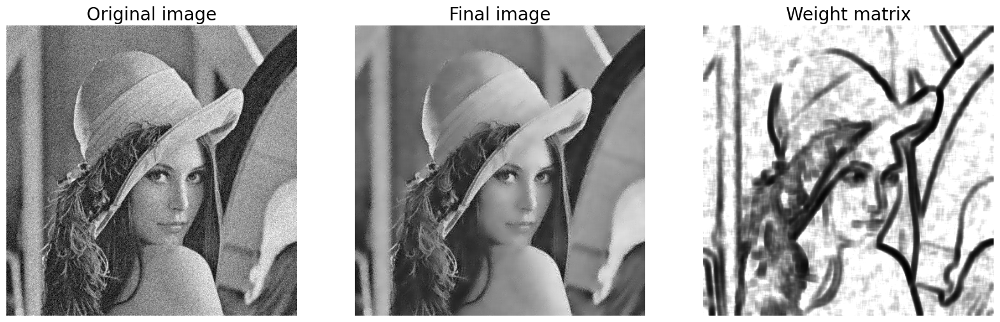

In [13]:
weight = noise_var/local_var
weight = np.clip(weight, None, 1)

img_est = img - weight*(img-avg)

fig, axes = plt.subplots(1,3, dpi=100, figsize=(20,20))
axs=axes.ravel()
axs[0].imshow(img, cmap='gray')
axs[0].set_title("Original image", fontsize=20)
axs[0].set_axis_off();
axs[1].imshow(img_est, cmap='gray');
axs[1].set_title("Final image", fontsize=20)
axs[1].set_axis_off();
axs[2].imshow(weight, cmap='gray')
axs[2].set_title("Weight matrix", fontsize=20);
axs[2].set_axis_off();

Sa slika iznad vidi se da su dobijeni veoma zadovoljavajući rezultati, sa uklonjenim šumom na uniformnim regionima i delimično očuvanim ivicama. Rezultati nisu savršeni, jer se uz ivice nalazi šum koji nije otklonjen zbog toga što je izabrano veliko lokalno susedstvo, ali bi za manje vrednosti radijusa $r$ šum na uniformnim regionima bio dosta primetniji. Pri izboru $r$ potrebno je balansirati između ova dva problema i napraviti takav izbor da finalni rezultati budu što bolji.

Kao argument za izbor $r=6$ u sledećem delu koda izvršeno je adaptivno lokalno usrednjavanje za vrednosti $r=4$ i $r=8$. Na osnovu poređenja svih rezultata može se dobro videti uticaj radijusa na rezultate i potvrditi doneta odluka o adekvatnom izboru radijusa.

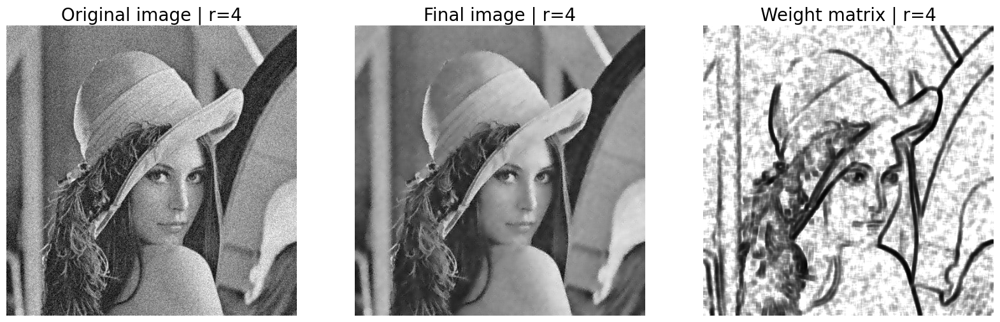

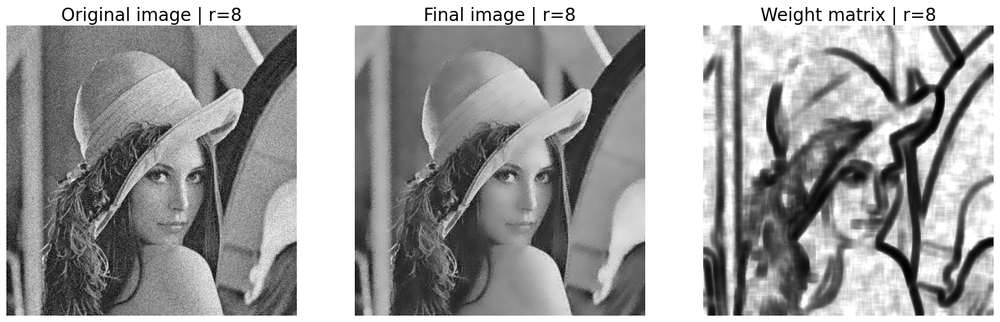

In [14]:
r=4
s = 2*r+1 # Calculate neighborhood dimension
    
# Calculate local variance matrix
filt = np.ones((s,s))/(s**2)
avg = ndimage.correlate(img, filt)
avg_sqr = ndimage.correlate(img**2,filt)
local_var = avg_sqr - avg**2

# Calculate local variance histogram
var_hist, bin_edges = np.histogram(local_var.flatten(), bins=70)
    
# Find estimated noise variance
noise_var = bin_edges[np.argmax(var_hist)]

weight = noise_var/local_var
weight = np.clip(weight, None, 1)

img_est = img - weight*(img-avg)

fig, axes = plt.subplots(1,3, dpi=100, figsize=(20,20))
axs=axes.ravel()
axs[0].imshow(img, cmap='gray')
axs[0].set_title("Original image | r=4", fontsize=20)
axs[0].set_axis_off();
axs[1].imshow(img_est, cmap='gray');
axs[1].set_title("Final image | r=4", fontsize=20)
axs[1].set_axis_off();
axs[2].imshow(weight, cmap='gray')
axs[2].set_title("Weight matrix | r=4", fontsize=20);
axs[2].set_axis_off();

r=8
s = 2*r+1 # Calculate neighborhood dimension
    
# Calculate local variance matrix
filt = np.ones((s,s))/(s**2)
avg = ndimage.correlate(img, filt)
avg_sqr = ndimage.correlate(img**2,filt)
local_var = avg_sqr - avg**2

# Calculate local variance histogram
var_hist, bin_edges = np.histogram(local_var.flatten(), bins=70)
    
# Find estimated noise variance
noise_var = bin_edges[np.argmax(var_hist)]

weight = noise_var/local_var
weight = np.clip(weight, None, 1)

img_est = img - weight*(img-avg)

fig, axes = plt.subplots(1,3, dpi=100, figsize=(20,20))
axs=axes.ravel()
axs[0].imshow(img, cmap='gray')
axs[0].set_title("Original image | r=8", fontsize=20)
axs[0].set_axis_off();
axs[1].imshow(img_est, cmap='gray');
axs[1].set_title("Final image | r=8", fontsize=20)
axs[1].set_axis_off();
axs[2].imshow(weight, cmap='gray')
axs[2].set_title("Weight matrix | r=8", fontsize=20);
axs[2].set_axis_off();

# Zadatak 4
U ovom zadatku potrebno je implementirati funkciju *dos_median(img_in, s_max, adaptive)* koja realizuje postupak adaptivnog ili standardnog medijan filtriranja, u zavisnosti od vrednosti parametara *adaptive*. Prilikom implementacije nije dozvoljeno koristiti ugrađene funkcije koje pomažu pri realizaciji algoritma.

## Brzina izvršavanja algoritma
Uslov da nije dozvoljeno korišćenje ugrađenih funkcija (poput one koja vrši sortiranje niza) ima ogroman uticaj na brzinu izvršavanja ove funkcije. Sve ugrađene funkcije izvršavaju se bez interpretacije jednog po jednog koraka algoritma koji je tom funkcijom implementiran, što mnogostruko ubrzava izvršavanje tog algoritma. Na primer, ugrađena funkcija *sort()* će uvek raditi brže od samostalno definisane funkcije u *Python-u*, jer se samostalno definisana funkcija interpretira liniju po liniju, za razliku od ugrađene funkcije koju je dovoljno interpretirati samo jednom.

Takođe, ogroman uticaj na brzinu izvršavanja iz istih razloga ima korišćenje petlji. Korišćenje matričnih izračunavanja je mnogo brže jer se petlja ne interpretira liniju po liniju, kao što je slučaj sa samostalno definisanom petljom.

## Pomoćne funkcije
Za definiciju funkcije *dos_median* prethodno su definisane pomoćne funkcije koje izvršavaju deo algoritma, dok je sama funkcija *dos_median* definisana kao omotač (*wrapper*) oko njih.

### Sortiranje
S obzirom da vrednosti piksela imaju opseg [0-255] u slučaju *uint8* ili [0-1] u slučaju *double* formata, za sortiranje se može primeniti *counting sort* algoritam čija je vremenska složenost O(n). Ovaj algoritam definiše se za celobrojne vrednosti niza koji se sortira (jer se one koriste kao indeksi), pa je u slučaju *double* formata piksela potrebno izvršiti konverziju u *uint8* format.

### Određivanje medijane
Medijana niza predstavlja vrednost niza za koju važi da je tačno polovina elemenata niza manja ili jednaka njoj, i tačno polovina elemenata niza veća ili jednaka njoj. Medijanu je jednostavno odrediti ukoliko je niz sortiran i poznata njegova dužina, jer je u tom slučaju medijana element čiji je indeks jednak polovini ukupne dužine niza.

### Proširenje slike
Filtriranje medijan filtrom realizuje se operacijom konvolucije, koja na izlazu daje sliku sa manjim dimenzijama. Kako bi se ovo izbeglo, potrebno je proširiti sliku tako da se nakon konvolucije dobije slika istih dimenzija kao originalna slika. Sliku je najlakše proširiti nulama, ali se u tom slučaju medijan regiona na krajevima slike pomera ka manjim vrednostima nego što zapravo jeste. Zbog toga je bolje sliku proširiti ponavljanjem onoliko najbližih redova ili kolona slike koliko je potrebno. Dijagonalni elementi ostaju popunjeni nulama, ali se ovako mnogo manje utiče na vrednost medijane regiona.

Takođe, treba naglasiti da je implementacija funkcije *dos_median* realizovana tako da se proširenje uvek radi tako da do redukcije dimenzija ne dođe u slučaju da se prilikom primene adaptivnog medijan filtriranja koristi najveće lokalno susedstvo. Tada se, u slučaju da manje lokalno susedstvo zadovoljava uslove za primenu adaptivnog medijan filtriranja, vrednosti piksela u proširenju ne poklapaju sa vrednostima piksela na krajevima slike. Međutim, pokazano je da ovakva realizacija ne utiče na rezultat, i da zadovoljava sve zahteve zadatka.

### Standardno medijan filtriranje
Standardno medijan filtriranje realizovano je tako što se za svaki piksel slike odredi lokalno susedstvo zadatih dimenzija. Pikseli svakog lokalnog susedstva se sortiraju, i određuje se medijana tog niza. Na kraju, centralni piksel susedstva se zamenjuje medijanom.

Medijan filtriranje je najbolje za otklanjanje impulsnog (*salt & pepper*) šuma, koga odlikuje iznenadna promena intenziteta piksela na minimalnu ili maksimalnu vrednost. Međutim, činjenice da se koristi fiksna dimenzija susedstva i postupak primenjuje na svaki piksel slike dovodi do neželjenih otklanjanja detalja. Detalji predstavljaju iznenadnu razliku intenziteta piksela, koja se medijan filtriranjem znatno smanjuje. Za očuvanje detalja mnogo je efikasnije koristiti adaptivno medijan filtriranje.

## Adaptivno medijan filtriranje
Adaptivno medijan filtriranje otklanja oba uzroka gubitka detalja kod standardnog medijan filtriranja. Za svaki piksel određuju se dimenzije lokalnog susedstva tako što se počevši od najmanjih dimenzija (3x3) ispituje da li je medijan ovog susedstva jednak ekstremnim vrednostima piksela (0 ili 255). Dimenzije se povećavaju sve dok se medijan susedstva ne poklapa ni sa jednom od ovih vrednosti. Dalje, ispituje se da li je centralni piksel posledica impulsnog šuma, tako što se ispituje da li je jednak nekoj od ekstremnih vrednosti piksela. Ukoliko jeste, njegov intenzitet se menja medijanom susedstva. Ovaj postupak ponavlja se za svaki piksel slike, čime se dobija slika sa otklonjenim šumom.

Sledeći deo koda obuhvata definicije gore objašnjenih pomoćnih funkcija, kao i definiciju same funkcije *dos_median*. Ona obuhvata ispitivanje ulaznih parametara, promenu reprezentacije slike ukoliko je ona potrebna, i primenu odgovarajućeg medijan filtra.

In [15]:
# Import modules
from numpy.core.fromnumeric import sort
from skimage import io, util
import numpy as np
import matplotlib.pyplot as plt
import time


def counting_sort(arr):
    """
    Return sorted array of np.uint8 type elements.

    Parameters
    -----
    arr: ndarray
        Array of np.uint8 type elements.

    Returns
    -----
    out : ndarray
        Sorted array.
    """

    n = arr.size # Get array size
    sorted_arr = np.zeros(n) # Initialize sorted array

    # Create helper array
    x = np.zeros(256, dtype=np.uint8)
    for i in range(0, n):
        x[arr[i]] += 1

    # Apply cumulative sum
    for i in range(1, 256):
        x[i] += x[i - 1]

    # Sort array
    for i in range(n-1,-1, -1):
        sorted_arr[x[arr[i]] - 1] = arr[i]
        x[arr[i]] -= 1

    return sorted_arr

def find_array_median(sorted_array, arr_len):
    """
    Return median of sorted array.

    Parameters
    -----
    sorted_array: ndarray
        Sorted array of np.uint8 type elements.

    arr_len: int
        Length of sorted_array.

    Returns
    -----
    out : int
        Median of the input array.
    """
    return sorted_array[int(arr_len/2)]

def add_padding(img, s):
    """
    Add padding to the input image.
    Top, bottom, left and right elements are copied from input image, and diagonal elements are filled with zeros.

    Parameters
    -----
    img: ndarray
        2D array of np.uint8 elements, representing grayscale image.

    s: int
        Neighborhood dimension size.

    Returns
    -----
    padded_img : ndarray
        Image with padding.
    """
    height, width = img.shape # Get input image dims

    # Calculate output image dims
    new_height = height + (s-1)
    new_width = width + (s-1)

    start = (s-1)//2 # Calculate index of element where input image starts

    # Create padded image
    padded_img = np.zeros((new_height, new_width), dtype=np.uint8)
    padded_img[start:start+height, start:start+width]=img # Fill with input image
    padded_img[:start, start:start+width]=img[:start, :] # Fill top
    padded_img[start+height:, start:start+width] = img[height-start:,:] # Fill bottom
    padded_img[start:start+height, :start]=img[:,:start] # Fill left
    padded_img[start:start+height, start+width:]=img[:,width-start:] # Fill right

    return padded_img

def standard_median(img, s):
    """
    Apply standard median filter to the input image.

    Parameters
    -----
    img: ndarray
        2D array of np.uint8 elements, representing grayscale image.

    s: int
        Neighborhood dimension size.

    Returns
    -----
    filtered_img : ndarray
        Image filtered using median filter.
    """
    height, width = img.shape # Get input image dims
    padded_img = add_padding(img, s) # Add padding

    filtered_img = np.zeros((height,width), dtype=np.uint8) # Create otput image

    # Filter image
    for i in range(height):
        for j in range(width):
            neighborhood = padded_img[i:i+s,j:j+s] # Extract neighborhood from padded image
            sorted_neighborhood=counting_sort(neighborhood.flatten()) # Sort neighborhood values
            filtered_img[i, j] = find_array_median(sorted_neighborhood, s**2) # Fill output image pixel with neighborhood median

    return filtered_img


def adaptive_median(img, s_max):
    """
    Apply adaptive median filter to the input image.

    Parameters
    -----
    img: ndarray
        2D array of np.uint8 elements, representing grayscale image.

    s_max: int
        Neighborhood dimension maximum size.

    Returns
    -----
    filtered_img : ndarray
        Image filtered using adaptive median filter.
    """

    height, width = img.shape # Get input image dims
    padded_img = add_padding(img, s_max) # Add padding to input image
    start = (s_max-1)//2 # Calculate index of element where input image starts

    # Filter image
    filtered_img = img.copy()

    for i in range(height):
        for j in range(width):

            # Find neighborhood
            s=3 # Minimum neighborhood dimension size
            while(True):
                s_start = (s-1)//2 # Calculate index of element where input image starts
                neighborhood = padded_img[i+start-s_start:i+start-s_start+s, j+start-s_start:j+start-s_start+s] # Extract neighborhood
                sorted_neighborhood=counting_sort(neighborhood.flatten()) # Sort neighborhood
                arr_med = find_array_median(sorted_neighborhood, s**2) # Find neighborhood median
                arr_max=sorted_neighborhood[s**2-1] # Find neighborhood maximum value
                arr_min=sorted_neighborhood[0] # Find neighborhood minimum value

                # Check if current neighborhood is valid
                if(s==s_max):break
                if(arr_med==arr_min or arr_med==arr_max):
                    s+=2
                else:
                    break

            # Apply adaptive median if current pixel is noisy
            if(filtered_img[i,j]==arr_max or filtered_img[i,j]==arr_min):
                filtered_img[i,j] = arr_med
    
    return filtered_img

def dos_median(img_in, s_max, adaptive):
    """
    Apply median or adaptive median filter to the input image.

    This function is a wrapper around standard_median and adaptive_median functions.
    It checks input parameters, and possibly converts np.float64 to np.uint8 image in order to successfully execute internal functions.

    Parameters
    -----
    img_in: ndarray
        2D array of np.uint8 or np.float64 elements, representing grayscale image.

    s_max: int
        Neighborhood dimension maximum size.

    adaptive: bool
        Flag which indicates whether standard median or adaptive median should be performed.

    Returns
    -----
    filtered_img : ndarray
        Image filtered using standard median or adaptive median filter.
    """

    # Check input parameters
    cond1 = isinstance(img_in[0,0], np.uint8)
    cond2 = isinstance(img_in[0,0], np.double)
    cond3 = isinstance(adaptive, bool)
    cond4 = (s_max%2)==1
    if(not ((cond1 or cond2) and cond3 and cond4)):
        print("Invalid input parameters!")
        return None
    
    # Process image if double
    if(cond2):
        img_in = util.img_as_ubyte(img_in)
    
    # Call corresponding function
    final_img = adaptive_median(img_in, s_max) if adaptive else standard_median(img_in, s_max)

    return (final_img if cond1 else util.img_as_float64(final_img))

## Testiranje funkcije za adaptivno filtriranje
Napisanu funkciju *dos_median* potrebno je testirati na slikama sa različitim brojem piksela pogođenih impulsnim šumom. Za testiranje je koriščena slika *rose.jpg*. Potrebno je uporediti rezultate sa rezultatima ugrađene funkcije za medijan filtriranje. Takođe, potrebno je prikazati normalizovano vreme izvršavanja u zavisnosti od veličine prozora.

Za testiranje adaptivnog filtriranja izabrana je maksimalna dimenzija susedstva $s\_max=13$. Rezultati se porede sa ugrađenom funkcijom *median* paketa *filters*.

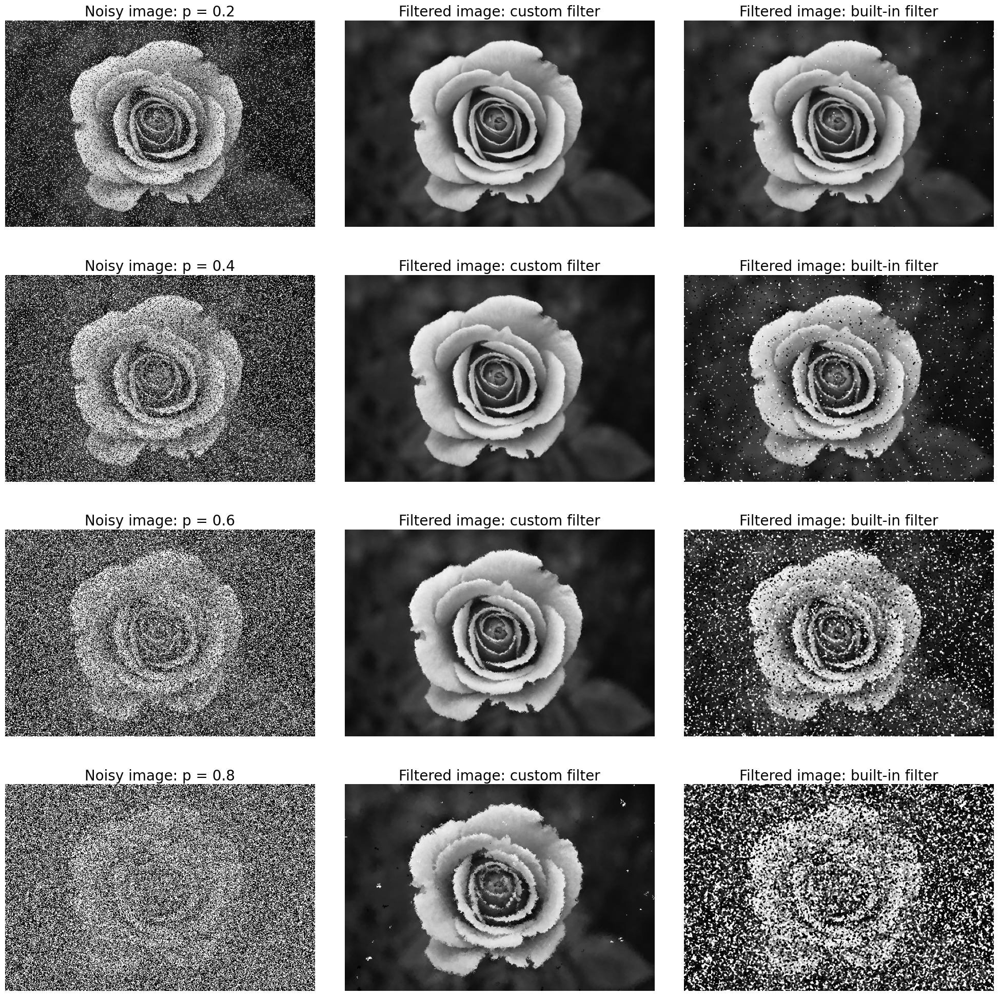

In [16]:
# Read image
img = io.imread('rose.jpg', as_gray=True)

noise_perc = [0.2, 0.4, 0.6, 0.8]

fig, axs =plt.subplots(len(noise_perc), 3, dpi=100, figsize=(20,20))
plt.tight_layout()
axs = axs.ravel()

for i, p in enumerate(noise_perc):
    
    noisy_img=util.random_noise(img, mode='s&p', amount=p) # Add noise
    # Filter image
    final_img=dos_median(noisy_img, 13, True)
    built_median = filters.median(noisy_img)
    
    axs[i*3].imshow(noisy_img, cmap='gray')
    axs[i*3].set_title('Noisy image: p = ' + str(p), fontsize=20)
    axs[i*3].set_axis_off()
    axs[3*i+1].imshow(final_img, cmap='gray')
    axs[3*i+1].set_title('Filtered image: custom filter', fontsize=20)
    axs[3*i+1].set_axis_off()
    axs[3*i+2].imshow(built_median, cmap='gray')
    axs[3*i+2].set_title('Filtered image: built-in filter', fontsize=20)
    axs[3*i+2].set_axis_off()
    

Rezultati pokazuju da je za bilo koju vrednost parametra $p$ funkcija *dos_median* dala dosta bolje rezultate od ugrađene funkcije, koja vrši standardno medijan filtriranje. Za $p=0.2$ i $p=0.4$ rezultat filtriranja se gotovo u potpunosti poklapa sa originalnom slikom. Za $p=0.6$ impulsni šum je takođe otklonjen, ali u ovom slučaju dolazi do degradacije ivica na slici. Konačno, za $p=0.8$ su i nakon filtriranja ostali vidljivi tragovi impulsnog šuma, i došlo je do dodatne degradacije ivica. Dodatnim povećanjem maksimalne dimenzije prozora $s_max$ ovi tragovi se mogu otkloniti, ali će to imati još nepovoljniji uticaj na ivice.

Iz gore navedenih razloga, vreme izvršavanja funkcije *dos_median* je mnogo veće od vremena izvršavanja ugrađene funkcije. Ovo bi se moglo poboljšati primenom matričnih operacija, ili izborom drugog programskog jezika (na primer C ili Cython).

## Analiza vremena izvršavanja

Poslednji deo zadatka obuhvata analizu uticaja veličine prozora na vreme izvršavanja operacije standardnog medijan filtriranja. Vreme izvršavanja potrebno je normalizovati brojem piksela slike.

U sledećem delu koda izvršene su gore navedene analize i prikazani su rezultati.

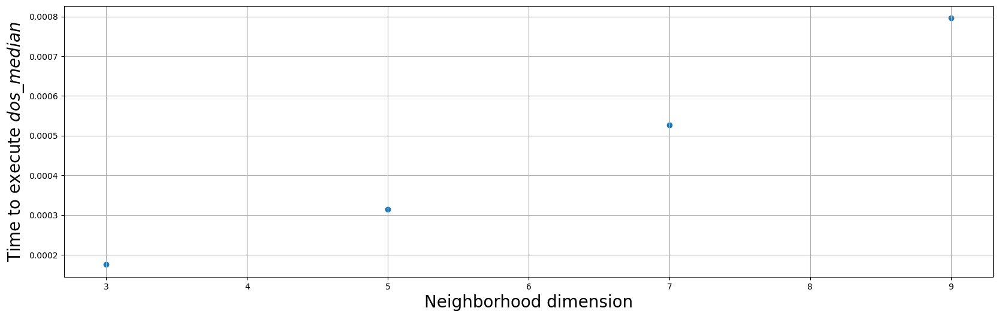

In [17]:

s_list = [3, 5, 7, 9]
times_list = []
normalized = []
noisy_img = util.random_noise(img, mode='s&p', amount=0.2) # Add noise

for i, s in enumerate(s_list):
    start = time.time()
    final_img = dos_median(noisy_img, s, False)
    end=time.time()
    times_list.append(end-start)
    normalized.append((end-start)/img.size)
    
plt.figure(figsize=(20,6), dpi=100)
plt.scatter(s_list, normalized)
plt.grid()
plt.xlabel('Neighborhood dimension', fontsize=20)
plt.ylabel('Time to execute $dos\_median$', fontsize=20);

Rezultati pokazuju vidljivu zavisnost brzine izvršavanja standardnog medijan filtriranja od veličine prozora. Brzina izvršavanja raste sa porastom dimenzija susedstva, zato što je za svaki piksel potrebno sortirati susedstvo. Iako algoritam *counting sort* ima vremensku složenost $O(n)$, broj elemenata susedstva raste kvadratno sa porastom parametra $s$. Kao u prethodnim razmatranjima, vreme izvršavanja se može smanjiti korišćenjem matričnih operacija, ugrađenih funkcija, ili izborom bržeg programskog jezika.